In [1]:
import sys
sys.path.insert(1,'/home/spencer/research/OpenRadar') # needed to import openradar not in folder
try: sys.path.remove('/opt/ros/kinetic/lib/python2.7/dist-packages') # fixes issues with env variables
except: pass

In [2]:
import numpy as np
import mmwave as mm
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import pickle
import os
import copy
from scipy.ndimage import gaussian_filter1d
from scipy import interpolate
from sklearn.preprocessing import minmax_scale

from pcp import pcp,complex_pcp,radar_pcp

## Getting the Data

In [3]:
radar_frames_path = 'radar_frames_csl_pantry.txt'
cfg_path = '/home/spencer/research/ti-radar-hardware/mmWave/scripts/configs/14xx/indoor_human_rcs.cfg' #radar config
rgb_dir_path = '/home/spencer/research/radar-rgb-bfs/RGB_images_csl_pantry'
camera_matrix_path = 'camera_mat.npy'

radar_frames = pickle.load(open(radar_frames_path,'rb'))
iwr_cfg_cmd = mm.dataloader.cfg_list_from_cfg(cfg_path) # this is the config sent to the radar
iwr_cfg_dict = mm.dataloader.cfg_list_to_dict(iwr_cfg_cmd) # this is the dictionary of config


images = np.array([plt.imread(os.path.join(rgb_dir_path, 'rgb_{}.png'.format(i)), 'gray') for i in range(len(radar_frames))])

camera_mat = np.load(camera_matrix_path)
fx = camera_mat[0,0]
x_c = camera_mat[0,2]

print('\n%d Radar Frames and %d RGB Frames Loaded'%(len(radar_frames),len(images)))

[NOTE] Azimuth angle can be determined from channel config.
[NOTE] Complex 1x mode

50 Radar Frames and 50 RGB Frames Loaded


In [4]:
# range resolution and bandwidth computation
(range_res, band_width) = mm.dsp.range_resolution(iwr_cfg_dict['profiles'][0]['adcSamples'],
                                                  iwr_cfg_dict['profiles'][0]['adcSampleRate'] / 1000,
                                                  iwr_cfg_dict['profiles'][0]['freqSlopeConst'] / 1e12)
# Doppler velocity resolution
dop_res = mm.dsp.doppler_resolution(band_width,
                                     start_freq_const=iwr_cfg_dict['profiles'][0]['start_frequency'] / 1e9,
                                     ramp_end_time=iwr_cfg_dict['profiles'][0]['rampEndTime'] * 1e6,
                                     idle_time_const=iwr_cfg_dict['profiles'][0]['idle'] * 1e6,
                                     num_loops_per_frame=iwr_cfg_dict['numChirps'] / len(iwr_cfg_dict['chirps']),
                                     num_tx_antennas=iwr_cfg_dict['numTx'])

## Display Original Data

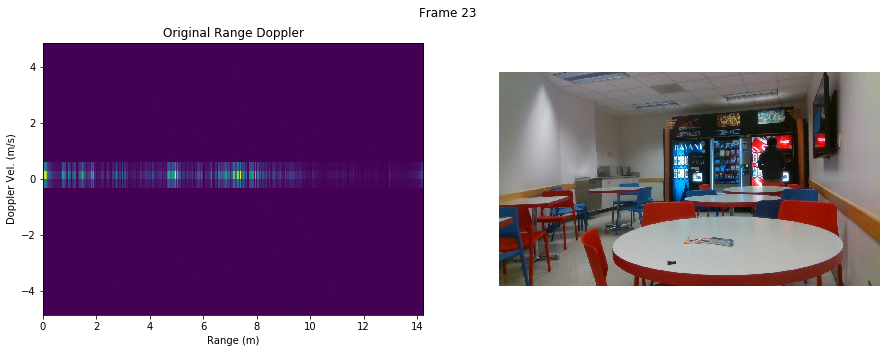

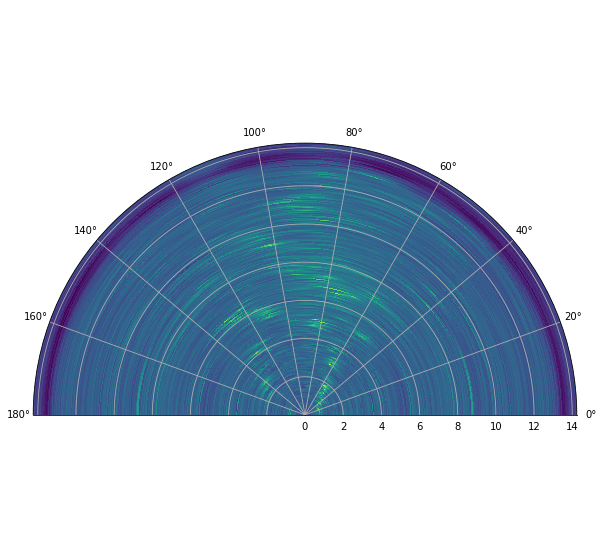

In [5]:
random_int = np.random.randint(0,len(radar_frames))
test_radar_frame = radar_frames[random_int]

test_radar_cube = mm.dsp.range_processing(test_radar_frame)
(test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                             num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                             interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                             accumulate=False,phase_correction=True)

test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



plt.figure(figsize=(15,5))
plt.suptitle('Frame %d'%random_int)
plt.subplot(121)
plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Original Range Doppler')
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.subplot(122)
plt.imshow(images[random_int])
plt.axis('off')
plt.show()



BINS_PROCESSED = test_doppler_cube.shape[0]  # If you want to zoom in plot, make this 120
VIRT_ANT = test_doppler_cube.shape[1]  # virtual antennas because we use time division multiple access to simulate a larger antenna array
DOPPLER_BINS = test_doppler_cube.shape[2]
ANGLE_RES = 1  # 1 degree resolution
ANGLE_RANGE = 90 # so we get 181 angle bins [0,180]
ANGLE_BINS = (ANGLE_RANGE * 2) // ANGLE_RES + 1
range_azimuth = np.zeros((ANGLE_BINS, BINS_PROCESSED), dtype=np.complex_)
num_vec, steering_vec = mm.dsp.gen_steering_vec(ANGLE_RANGE, ANGLE_RES, VIRT_ANT) # steering vector is a(theta) in most literature

beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

plt.figure(figsize=(15,10))
plt.tight_layout(True)
plt.subplot(111, projection='polar')
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.show()

## Clutter Suppression

#### Subtract Mean Over Chirps for each frame

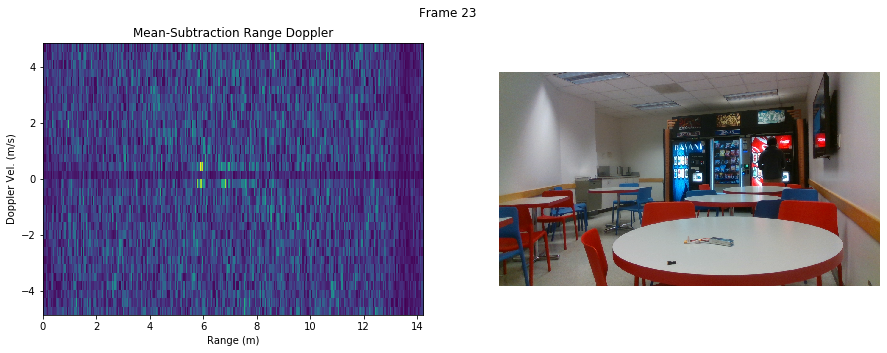

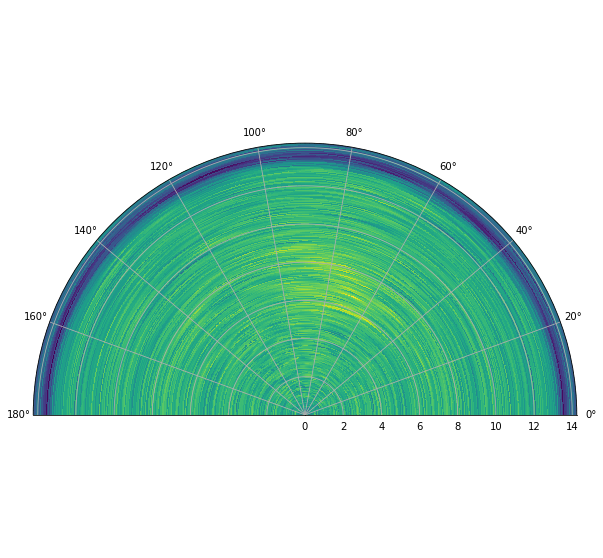

In [6]:
test_radar_frame = radar_frames[random_int]

test_radar_cube = mm.dsp.range_processing(test_radar_frame)
mean = test_radar_cube.mean(0)                 
test_radar_cube = test_radar_cube - mean


(test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                             num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                             interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                             accumulate=False,phase_correction=True)

test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



plt.figure(figsize=(15,5))
plt.suptitle('Frame %d'%random_int)
plt.subplot(121)
plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
           extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
plt.title('Mean-Subtraction Range Doppler')
plt.xlabel('Range (m)')
plt.ylabel('Doppler Vel. (m/s)')
plt.subplot(122)
plt.imshow(images[random_int])
plt.axis('off')
plt.show()

beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


for jj in range(BINS_PROCESSED):
    beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

plt.figure(figsize=(15,10))
plt.tight_layout(True)
plt.subplot(111, projection='polar')
# # cartesian coordinates (looks like real life)
# beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
#
azimuths = np.radians(np.linspace(0, 180, 181))
zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
r, theta = np.meshgrid(zeniths, azimuths)
values = beamforming_result.T
plt.pcolormesh(theta, r, np.log(np.abs(values)))
plt.grid()
plt.xlim([0,np.pi])
plt.show()

## Determining Bounds

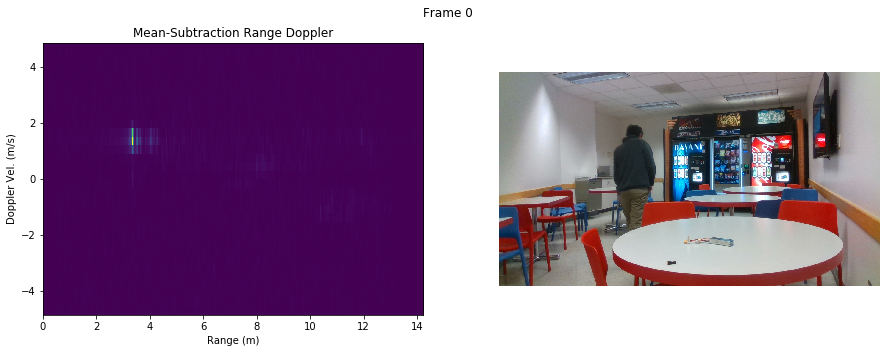

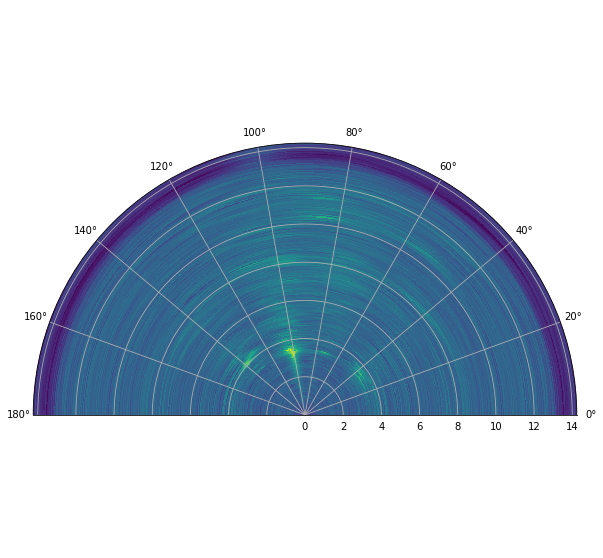

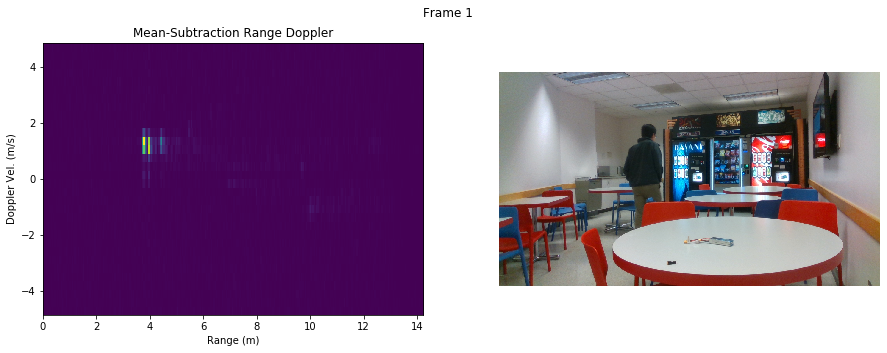

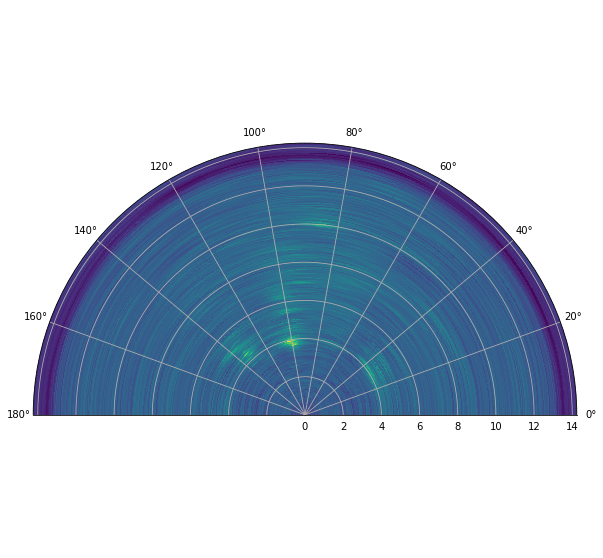

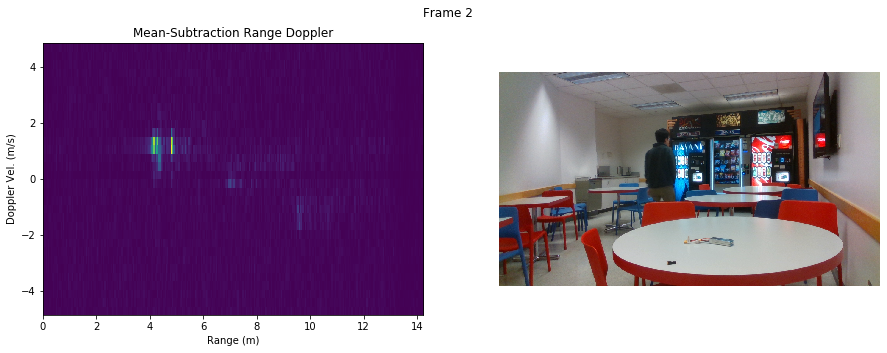

...

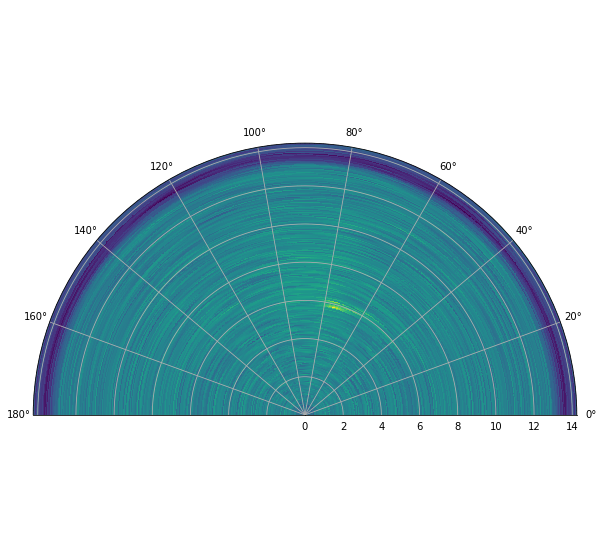

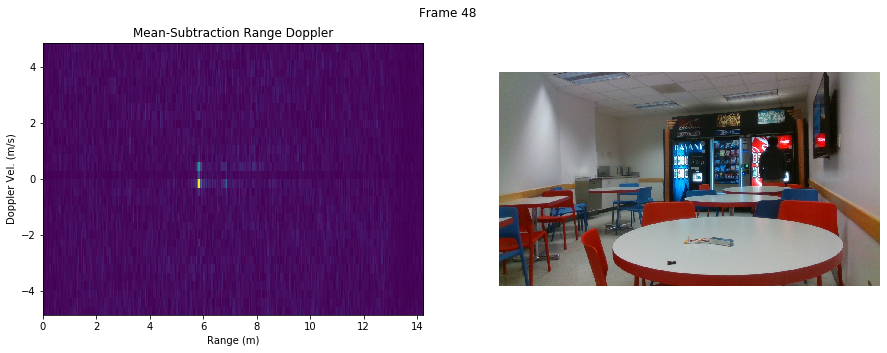

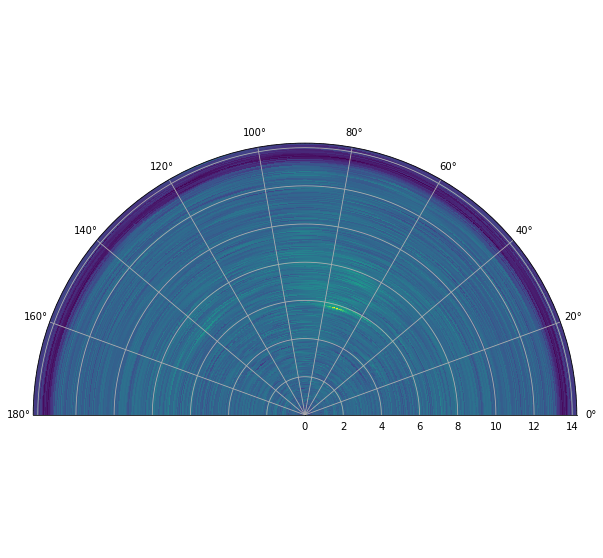

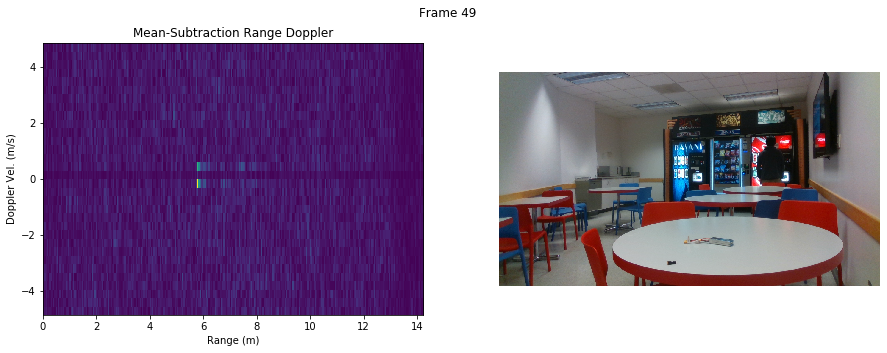

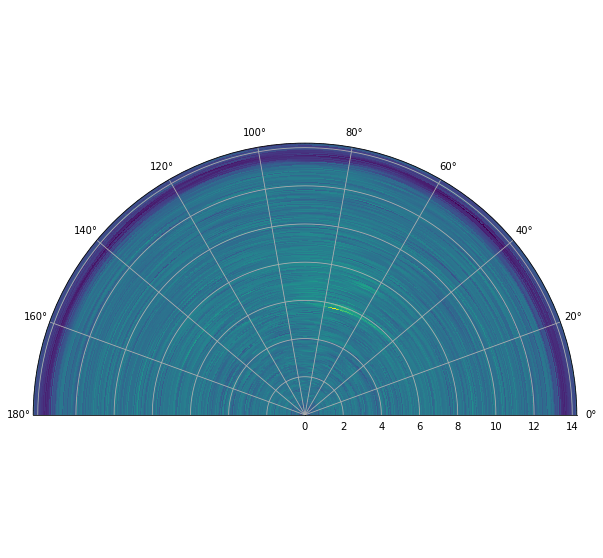

In [7]:
radar_range_azs = []
for ii in range(len(radar_frames)):
    test_radar_frame = radar_frames[ii]
    test_radar_cube = mm.dsp.range_processing(test_radar_frame)
    mean = test_radar_cube.mean(0)                 
    test_radar_cube = test_radar_cube - mean


    (test_log_doppler_cube, test_doppler_cube) = mm.dsp.doppler_processing(test_radar_cube,
                                                 num_tx_antennas=iwr_cfg_dict['numTx'], clutter_removal_enabled=False,
                                                 interleaved=False, window_type_2d=mm.dsp.utils.Window.HAMMING,
                                                 accumulate=False,phase_correction=True)

    test_doppler_cube = np.fft.fftshift(test_doppler_cube, axes=(2,))
    test_log_doppler_cube = np.fft.fftshift(test_log_doppler_cube, axes=(2,))



    plt.figure(figsize=(15,5))
    plt.suptitle('Frame %d'%ii)
    plt.subplot(121)
    plt.imshow(np.abs(test_doppler_cube[:,0]).T,aspect='auto',origin='lower', 
               extent=[0,304*range_res,-test_log_doppler_cube.shape[2] * dop_res / 2, test_log_doppler_cube.shape[2] * dop_res / 2])
    plt.title('Mean-Subtraction Range Doppler')
    plt.xlabel('Range (m)')
    plt.ylabel('Doppler Vel. (m/s)')
    plt.subplot(122)
    plt.imshow(images[ii])
    plt.axis('off')
    plt.show()

    beamforming_result = np.zeros([BINS_PROCESSED,ANGLE_BINS],dtype=np.complex_) # range bins x angle bins


    for jj in range(BINS_PROCESSED):
        beamforming_result[jj,:], _ = mm.dsp.aoa_capon(test_doppler_cube[jj], steering_vec)

    radar_range_azs.append(np.flip(beamforming_result,axis=1))
    plt.figure(figsize=(15,10))
    plt.tight_layout(True)
    plt.subplot(111, projection='polar')
    # # cartesian coordinates (looks like real life)
    # beamforming_result = np.flip(beamforming_result,axis=1)  # dont know why we need this but we'll be using own polar transform in future
    #
    azimuths = np.radians(np.linspace(0, 180, 181))
    zeniths = np.linspace(0, range_res*BINS_PROCESSED, BINS_PROCESSED)
    r, theta = np.meshgrid(zeniths, azimuths)
    values = beamforming_result.T
    plt.pcolormesh(theta, r, np.log(np.abs(values)))
    plt.grid()
    plt.xlim([0,np.pi])
    plt.show()

In [8]:
radar_az_amps = [np.sum(np.abs(r_a),axis=0) for r_a in radar_range_azs] 
radar_az_log_amps = [np.log(a_a) for a_a in radar_az_amps]

In [9]:
# determine FOV in deg
right = images[0].shape[1]
left = 0


print('Left Min Angle', 180/np.pi*np.arctan((left-x_c)/fx))
print('Right Max Angle', 180/np.pi*np.arctan((right-x_c)/fx))


pixel_angles = 180/np.pi*np.arctan((np.arange(right)-x_c)/fx)
front_angles = np.arange(-90,91)

Left Min Angle -35.16107322153295
Right Max Angle 34.346996918680944


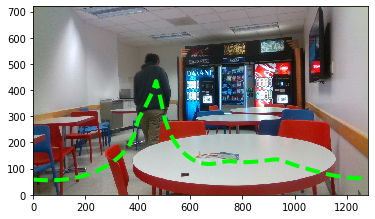

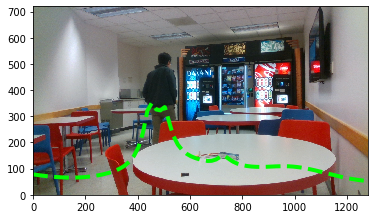

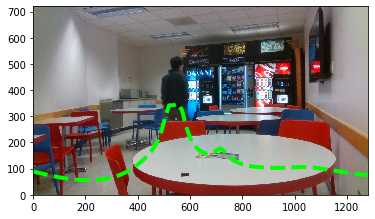

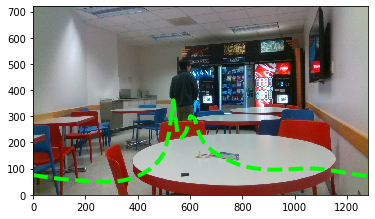

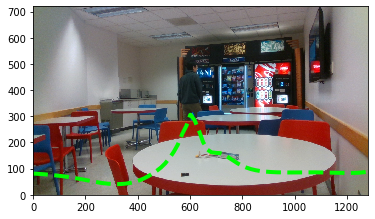

...

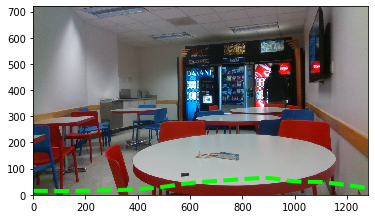

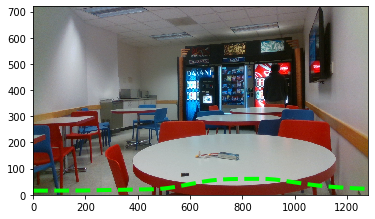

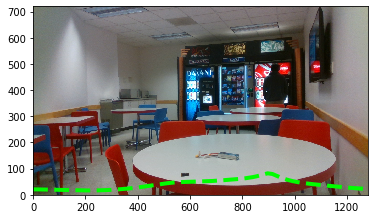

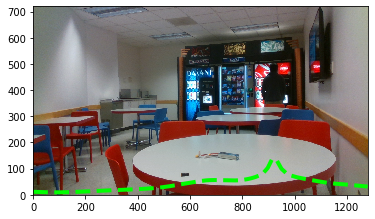

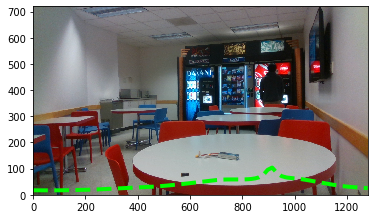

In [10]:
front_angles = np.arange(-90,91)
pixel_amplitudes = []

for frame_idx in range(len(radar_az_amps)):
    radar_az_log_amp = radar_az_log_amps[frame_idx]
    
    f = interpolate.interp1d(front_angles,radar_az_log_amp)
    pixel_amps = f(pixel_angles)-np.min(radar_az_log_amps)
    pixel_amplitudes.append(pixel_amps)
    plt.imshow(images[frame_idx],extent=[0,1280,0,720])
    plt.plot((pixel_amps)*200,'--',c='lime',linewidth=4)
    plt.show()
    

In [11]:
# because high prob should have low cost for M_F

l_bound = 1
u_bound = .1

pixel_amplitudes -= np.min(pixel_amplitudes)
pixel_amplitudes /= np.max(pixel_amplitudes)
pixel_cost_amplitudes = pixel_amplitudes * (u_bound-l_bound) + l_bound

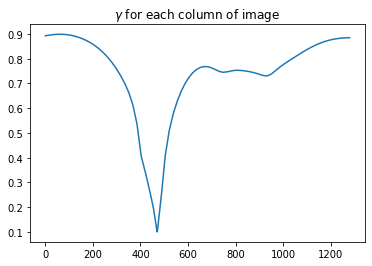

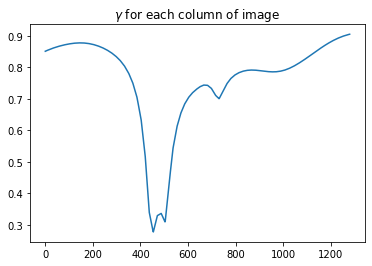

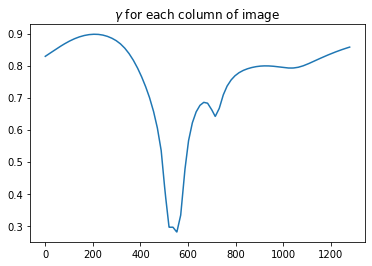

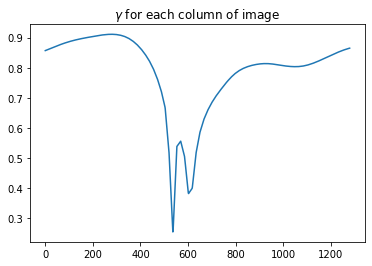

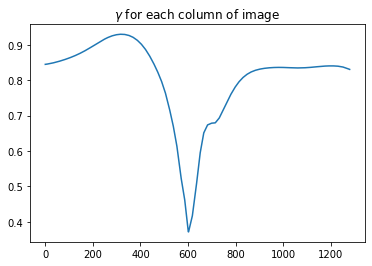

...

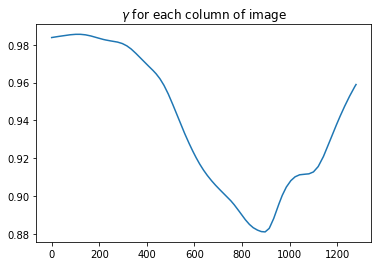

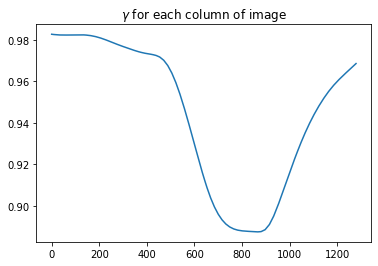

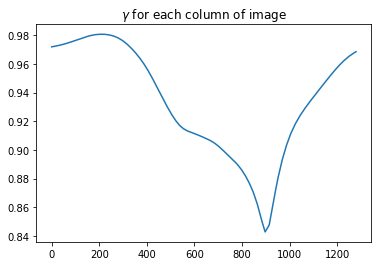

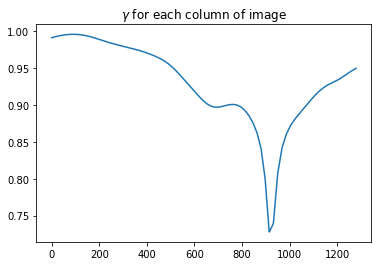

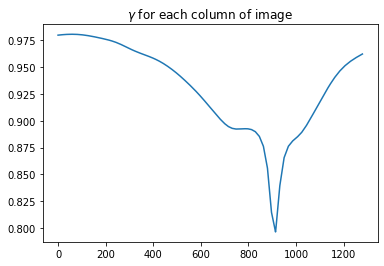

In [12]:
for ii in pixel_cost_amplitudes:
    plt.plot(ii)
    plt.title('$\gamma$ for each column of image')
    plt.show()

In [13]:
M_F = pixel_cost_amplitudes[:,:,np.newaxis] * np.ones((images.shape[0],images.shape[2],images.shape[1]))
M_F = np.swapaxes(M_F,1,2).reshape(images.shape[0],-1)
M_F = M_F.T

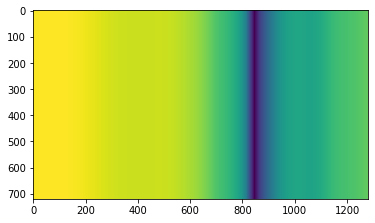

In [14]:
plt.imshow(M_F[:,10].reshape(720,-1))

## RPCA

In [15]:
def rgb2gray(rgb):
    return np.dot(rgb[...,:3], [0.2989, 0.5870, 0.1140])
images_bw = np.array([rgb2gray(image) for image in images])

In [16]:
D = images_bw.reshape(images_bw.shape[0], -1).T

In [23]:
L_pcp, S_pcp, _, errors, ranks, nnzs = pcp(D, verbose=True, maxiter=200)

mu = 0.0022753620988979458
Iteration 0: error=1.965e-03, rank=50, nnz=3058729, time=1.847e+00
Iteration 1: error=2.305e-04, rank=50, nnz=4105850, time=1.829e+00
Iteration 2: error=1.422e-04, rank=50, nnz=4806344, time=1.698e+00
Iteration 3: error=1.328e-04, rank=50, nnz=5488074, time=1.704e+00
Iteration 4: error=1.307e-04, rank=50, nnz=6179182, time=1.705e+00
Iteration 5: error=1.291e-04, rank=50, nnz=6874427, time=1.701e+00
Iteration 6: error=1.271e-04, rank=50, nnz=7568377, time=1.703e+00
Iteration 7: error=1.249e-04, rank=50, nnz=8255136, time=1.700e+00
Iteration 8: error=1.229e-04, rank=50, nnz=8932009, time=1.697e+00
Iteration 9: error=1.211e-04, rank=50, nnz=9596627, time=1.698e+00
Iteration 10: error=1.192e-04, rank=50, nnz=10249291, time=1.700e+00
Iteration 11: error=1.172e-04, rank=50, nnz=10890006, time=1.697e+00
Iteration 12: error=1.150e-04, rank=50, nnz=11515116, time=1.700e+00
Iteration 13: error=1.132e-04, rank=50, nnz=12122673, time=1.702e+00
Iteration 14: error=1.112e-

Iteration 120: error=3.631e-05, rank=7, nnz=24530892, time=8.067e-01
Iteration 121: error=3.683e-05, rank=7, nnz=24531322, time=8.066e-01
Iteration 122: error=3.578e-05, rank=7, nnz=24535091, time=8.067e-01
Iteration 123: error=3.521e-05, rank=7, nnz=24537846, time=8.037e-01
Iteration 124: error=3.591e-05, rank=7, nnz=24538157, time=8.036e-01
Iteration 125: error=3.494e-05, rank=7, nnz=24539710, time=8.148e-01
Iteration 126: error=3.579e-05, rank=8, nnz=24539004, time=8.138e-01
Iteration 127: error=3.419e-05, rank=7, nnz=24543146, time=8.893e-01
Iteration 128: error=3.366e-05, rank=8, nnz=24546855, time=8.067e-01
Iteration 129: error=3.324e-05, rank=8, nnz=24549887, time=9.018e-01
Iteration 130: error=3.278e-05, rank=7, nnz=24552156, time=9.085e-01
Iteration 131: error=3.340e-05, rank=6, nnz=24556008, time=8.334e-01
Iteration 132: error=3.300e-05, rank=7, nnz=24555699, time=7.789e-01
Iteration 133: error=3.490e-05, rank=6, nnz=24556661, time=8.648e-01
Iteration 134: error=3.162e-05, ra

Iteration 199: error=2.490e-05, rank=7, nnz=24635448, time=8.090e-01


In [24]:
L_radar, S_radar, _, errors_radar, ranks_radar, nnzs_radar = radar_pcp(D, M_F, verbose=True, maxiter=200)

mu = 0.0022753620988979458
Iteration 0: error=1.892e-03, rank=50, nnz=3717316, time=1.809e+00
Iteration 1: error=2.263e-04, rank=50, nnz=4924302, time=1.702e+00
Iteration 2: error=1.412e-04, rank=50, nnz=5732796, time=1.695e+00
Iteration 3: error=1.328e-04, rank=50, nnz=6524373, time=1.712e+00
Iteration 4: error=1.316e-04, rank=50, nnz=7332452, time=1.793e+00
Iteration 5: error=1.309e-04, rank=50, nnz=8151962, time=1.711e+00
Iteration 6: error=1.301e-04, rank=50, nnz=8976579, time=1.900e+00
Iteration 7: error=1.289e-04, rank=50, nnz=9801822, time=1.792e+00
Iteration 8: error=1.279e-04, rank=50, nnz=10621909, time=1.918e+00
Iteration 9: error=1.270e-04, rank=50, nnz=11435021, time=1.701e+00
Iteration 10: error=1.263e-04, rank=50, nnz=12238203, time=1.706e+00
Iteration 11: error=1.253e-04, rank=50, nnz=13026805, time=1.707e+00
Iteration 12: error=1.244e-04, rank=50, nnz=13799948, time=2.396e+00
Iteration 13: error=1.236e-04, rank=50, nnz=14551185, time=3.698e+00
Iteration 14: error=1.229

Iteration 120: error=3.834e-05, rank=4, nnz=25044783, time=7.217e-01
Iteration 121: error=3.768e-05, rank=4, nnz=25048431, time=7.251e-01
Iteration 122: error=3.733e-05, rank=4, nnz=25050471, time=7.107e-01
Iteration 123: error=3.671e-05, rank=4, nnz=25053809, time=6.374e-01
Iteration 124: error=3.625e-05, rank=4, nnz=25055911, time=6.333e-01
Iteration 125: error=3.591e-05, rank=4, nnz=25058534, time=6.370e-01
Iteration 126: error=3.527e-05, rank=4, nnz=25062354, time=6.975e-01
Iteration 127: error=3.487e-05, rank=4, nnz=25065018, time=6.390e-01
Iteration 128: error=3.455e-05, rank=4, nnz=25067350, time=6.803e-01
Iteration 129: error=3.419e-05, rank=4, nnz=25070412, time=6.591e-01
Iteration 130: error=3.427e-05, rank=4, nnz=25071852, time=6.433e-01
Iteration 131: error=3.340e-05, rank=5, nnz=25075761, time=7.223e-01
Iteration 132: error=3.268e-05, rank=4, nnz=25079480, time=6.801e-01
Iteration 133: error=3.206e-05, rank=4, nnz=25082593, time=6.461e-01
Iteration 134: error=3.417e-05, ra

Iteration 199: error=1.608e-05, rank=4, nnz=25192519, time=8.361e-01


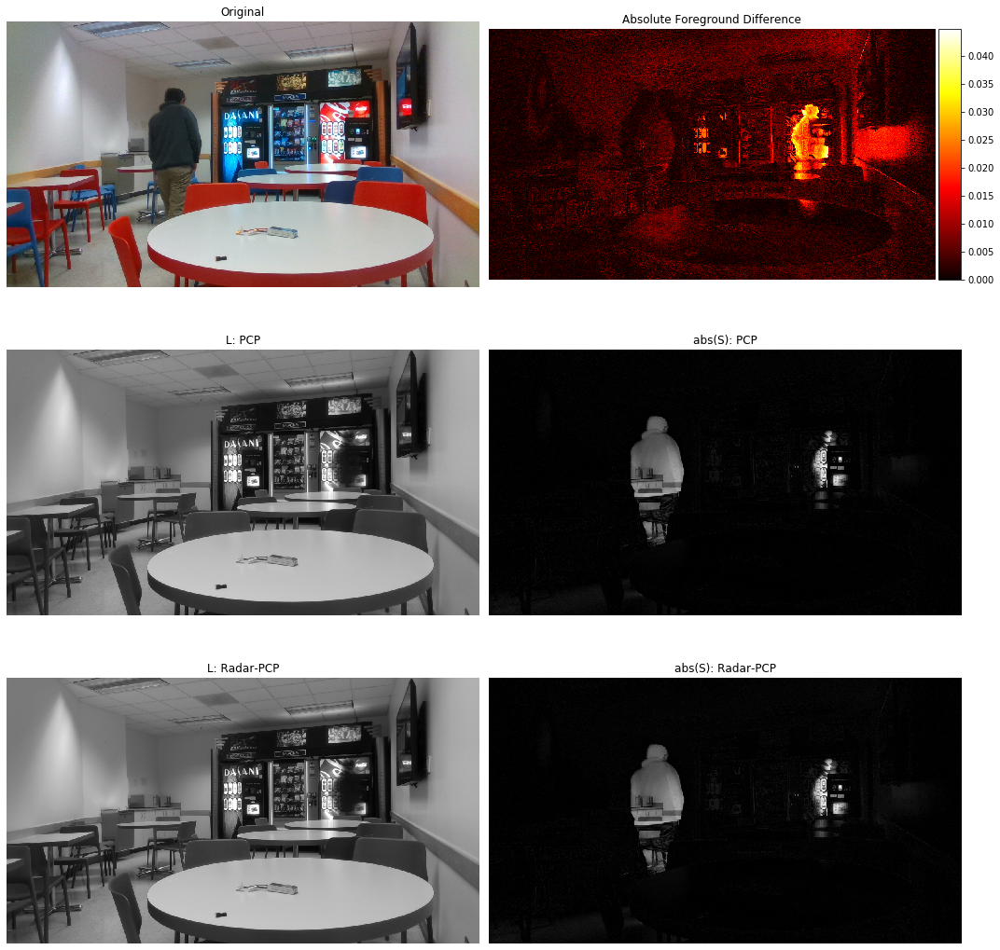

In [27]:
i = 0
plt.figure(figsize=(15,15))
plt.subplot(321)
plt.title('Original')
plt.imshow(images[i], 'gray')
plt.axis('off')
plt.subplot(322)
ax = plt.gca()

plt.title('Absolute Foreground Difference')
im = ax.imshow(np.abs((S_radar[:, i]-S_pcp[:, i])/255).reshape(images.shape[1], images.shape[2]), 'hot')
# plt.title('S_radar-S_normal')
# im = ax.imshow(((S_radar[:, i]-S_pcp[:, i])/255).reshape(images.shape[1], images.shape[2]), 'hot')

plt.axis('off')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.subplot(323)
plt.title('L: PCP')
plt.imshow(L_pcp[:, i].reshape(images.shape[1], images.shape[2]), 'gray')
plt.axis('off')
plt.subplot(324)
plt.title('abs(S): PCP')
plt.imshow(abs(S_pcp[:, i].reshape(images.shape[1], images.shape[2])), 'gray')
plt.axis('off')
plt.subplot(325)
plt.title('L: Radar-PCP')
plt.imshow(L_radar[:, i].reshape(images.shape[1], images.shape[2]), 'gray')
plt.axis('off')
plt.subplot(326)
plt.title('abs(S): Radar-PCP')
plt.imshow(abs(S_radar[:, i].reshape(images.shape[1], images.shape[2])), 'gray')
plt.axis('off')


plt.colorbar(im, cax=cax)
plt.tight_layout()

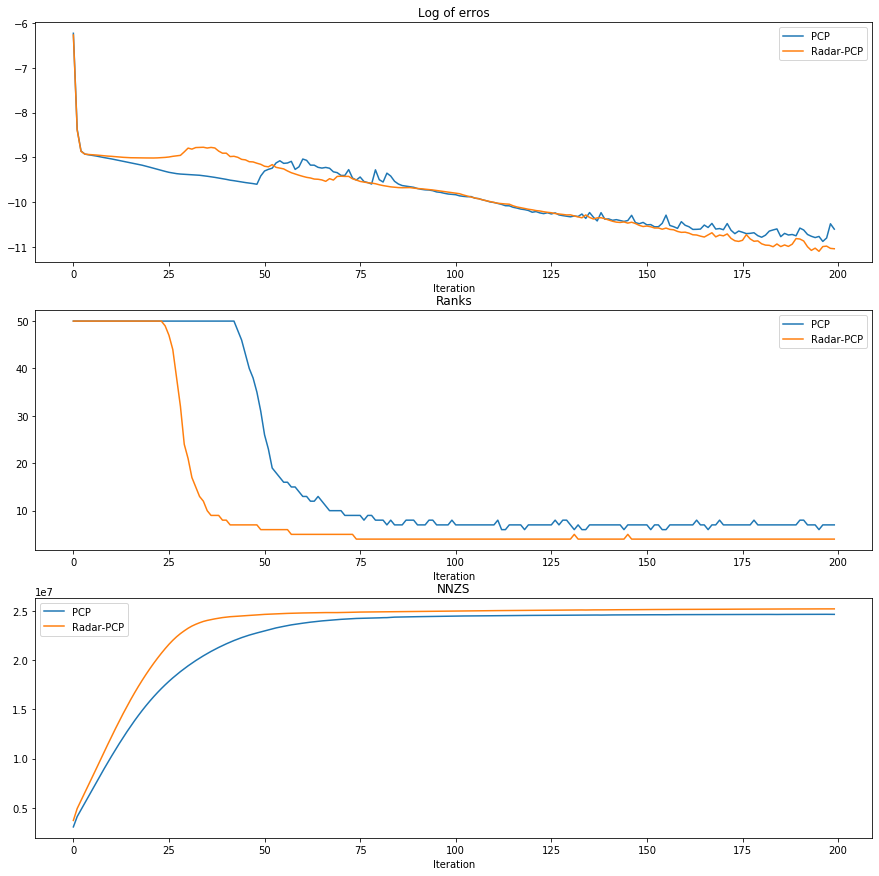

In [26]:
plt.figure(figsize=(15,15))
plt.subplot(311)
plt.plot(np.log(errors),label='PCP')
plt.plot(np.log(errors_radar),label='Radar-PCP')
plt.legend()
plt.title('Log of erros')
plt.xlabel('Iteration')
plt.subplot(312)
plt.plot(ranks,label='PCP')
plt.plot(ranks_radar,label='Radar-PCP')
plt.legend()
plt.title('Ranks')
plt.xlabel('Iteration')
plt.subplot(313)
plt.plot(nnzs,label='PCP')
plt.plot(nnzs_radar,label='Radar-PCP')
plt.legend()
plt.title('NNZS')
plt.xlabel('Iteration')
plt.show()